#import

In [ ]:
import sys
import sktime
import tqdm as tq
import xgboost as xgb
import matplotlib
import seaborn as sns
import sklearn as skl
import pandas as pd
import numpy as np
print("-------------------------- Python & library version --------------------------")
print("Python version: {}".format(sys.version))
print("pandas version: {}".format(pd.__version__))
print("numpy version: {}".format(np.__version__))
print("matplotlib version: {}".format(matplotlib.__version__))
print("tqdm version: {}".format(tq.__version__))
print("sktime version: {}".format(sktime.__version__))
print("xgboost version: {}".format(xgb.__version__))
print("seaborn version: {}".format(sns.__version__))
print("scikit-learn version: {}".format(skl.__version__))
print("------------------------------------------------------------------------------")

-------------------------- Python & library version --------------------------
Python version: 3.10.6 (main, May 29 2023, 11:10:38) [GCC 11.3.0]
pandas version: 1.5.3
numpy version: 1.22.4
matplotlib version: 3.7.1
tqdm version: 4.65.0
sktime version: 0.21.0
xgboost version: 1.7.6
seaborn version: 0.12.2
scikit-learn version: 1.2.2
------------------------------------------------------------------------------


In [ ]:
import matplotlib.pyplot as plt
from tqdm import tqdm
from sktime.forecasting.model_selection import temporal_train_test_split
from sktime.utils.plotting import plot_series
from xgboost import XGBRegressor

pd.set_option('display.max_columns', 30)

#load data

In [ ]:

train_df = pd.read_csv("train.csv")
test_df = pd.read_csv("test.csv")
building_info_df = pd.read_csv("building_info.csv")



In [ ]:
test_df = test_df.fillna(method='ffill')
test_df = test_df.fillna(0)

In [ ]:
train_df = train_df.fillna(method='ffill')
train_df = train_df.fillna(0)

In [ ]:
train_df.columns = ['num_date','build_idx','yyyymmdd hh','temp','rain_amount','wind','humid','일조','일사','target']

test_df.columns = ['num_date','build_idx','yyyymmdd hh','temp','rain_amount','wind','humid']

In [ ]:
def process(df):
  date = pd.to_datetime(df['yyyymmdd hh'], format='%Y%m%d %H')
  df['hour'] = date.dt.hour
  df['day'] = date.dt.weekday
  df['month'] = date.dt.month
  df['week'] = date.dt.weekofyear
  df['holiday'] = df.apply(lambda x : 0 if x['day']<5 else 1, axis = 1) #주말


  ## https://dacon.io/competitions/official/235680/codeshare/2366?page=1&dtype=recent 시간 푸리에 변환
  df['sin_time'] = np.sin(2*np.pi*df.hour/24)
  df['cos_time'] = np.cos(2*np.pi*df.hour/24)


  ## https://dacon.io/competitions/official/235736/codeshare/2743?page=1&dtype=recent 불쾌지수
  df['THI'] = 9/5*df['temp'] - 0.55*(1-df['humid']/100)*(9/5*df['humid']-26)+32



  def CDH(xs): # cooling degree hour
      ys = []
      for i in range(len(xs)):
          if i < 11:
              ys.append(np.sum(xs[:(i+1)]-26))
          else:
              ys.append(np.sum(xs[(i-11):(i+1)]-26))
      return np.array(ys)

  cdhs = np.array([])
  for num in range(1,101,1):
      temp = df[df['build_idx'] == num]
      cdh = CDH(temp['temp'].values)
      cdhs = np.concatenate([cdhs, cdh])
  df['CDH'] = cdhs

  return df

train_df = process(train_df)
test_df = process(test_df)

<ipython-input-9-023a0ebd3eb5>:6: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  df['week'] = date.dt.weekofyear
<ipython-input-9-023a0ebd3eb5>:6: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  df['week'] = date.dt.weekofyear


In [ ]:
train_df.drop(['num_date','yyyymmdd hh','일조','일사','hour'], axis = 1, inplace = True)
train_df.head()

,build_idx,temp,rain_amount,wind,humid,target,day,month,week,holiday,sin_time,cos_time,THI,CDH
0,1,18.6,0.0,0.9,42.0,1085.28,2,6,22,0,0.000000,1.000000,49.6576,-7.4
1,1,18.0,0.0,1.1,45.0,1047.36,2,6,22,0,0.258819,0.965926,47.7625,-15.4
2,1,17.7,0.0,1.5,45.0,974.88,2,6,22,0,0.500000,0.866025,47.2225,-23.7
3,1,16.7,0.0,1.4,48.0,953.76,2,6,22,0,0.707107,0.707107,44.7856,-33.0
4,1,18.4,0.0,2.8,43.0,986.40,2,6,22,0,0.866025,0.500000,49.0061,-40.6


In [ ]:
test_df.drop(['num_date','yyyymmdd hh','hour'], axis = 1, inplace = True)
test_df.head()

,build_idx,temp,rain_amount,wind,humid,day,month,week,holiday,sin_time,cos_time,THI,CDH
0,1,23.5,0.0,2.2,72,3,8,34,0,0.000000,1.000000,58.3456,-2.5
1,1,23.0,0.0,0.9,72,3,8,34,0,0.258819,0.965926,57.4456,-5.5
2,1,22.7,0.0,1.5,75,3,8,34,0,0.500000,0.866025,57.8725,-8.8
3,1,22.1,0.0,1.3,78,3,8,34,0,0.707107,0.707107,57.9376,-12.7
4,1,21.8,0.0,1.0,77,3,8,34,0,0.866025,0.500000,56.9961,-16.9


#special functions

In [ ]:
#### alpha를 argument로 받는 함수로 실제 objective function을 wrapping하여 alpha값을 쉽게 조정할 수 있도록 작성했습니다.
# custom objective function for forcing model not to underestimate
def weighted_mse(alpha = 1):
    def weighted_mse_fixed(label, pred):
        residual = (label - pred).astype("float")
        grad = np.where(residual>0, -2*alpha*residual, -2*residual)
        hess = np.where(residual>0, 2*alpha, 2.0)
        return grad, hess
    return weighted_mse_fixed

In [ ]:
# Define SMAPE loss function
def SMAPE(true, pred):
    return np.mean((np.abs(true-pred))/(np.abs(true) + np.abs(pred))) * 200

# xgboost 예시

train data shape
x:(1872, 12), y:(1872,)


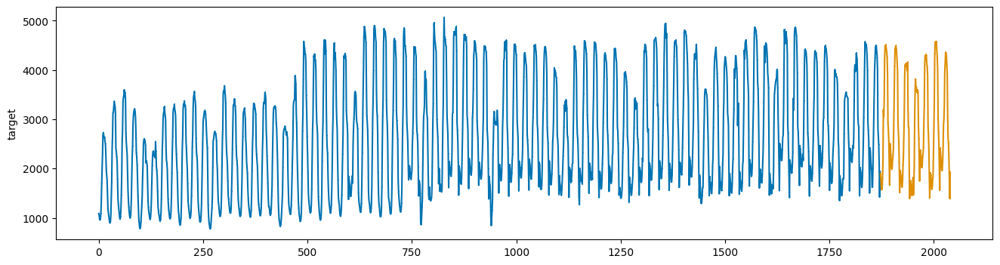

In [ ]:
## 7번 건물의 발전량
y = train_df.loc[train_df.build_idx == 1, 'target']
x = train_df.loc[train_df.build_idx == 1].drop(columns='target').iloc[:,1:]

y_train, y_valid, x_train, x_valid = temporal_train_test_split(y = y, X = x, test_size = 168) # 24시간*7일 = 168

print('train data shape\nx:{}, y:{}'.format(x_train.shape, y_train.shape))

plot_series(y_train, y_valid, markers=[',' , ','])
plt.show()

In [ ]:
#xgb_reg = XGBRegressor(n_estimators = 10000, seed=0, gpu_id = 0,)
xgb_reg = XGBRegressor(n_estimators = 1000, seed=0, gpu_id = 0,colsample_bytree=0.9, eta=0.01, max_depth=5,min_child_weight=6, subsample=0.9)
xgb_reg.fit(x_train, y_train, eval_set=[(x_train, y_train), (x_valid, y_valid)],
        early_stopping_rounds=300,
       verbose=False)

/usr/local/lib/python3.10/dist-packages/xgboost/sklearn.py:835: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.9, early_stopping_rounds=None,
             enable_categorical=False, eta=0.01, eval_metric=None,
             feature_types=None, gamma=None, gpu_id=0, grow_policy=None,
             importance_type=None, interaction_constraints=None,
             learning_rate=None, max_bin=None, max_cat_threshold=None,
             max_cat_to_onehot=None, max_delta_step=None, max_depth=5,
             max_leaves=None, min_child_weight=6, missing=nan,
             monotone_constraints=None, n_estimators=1000, n_jobs=None,
             num_parallel_tree=None, predictor=None, ...)

best iterations: 999
SMAPE : 5.875350622882864


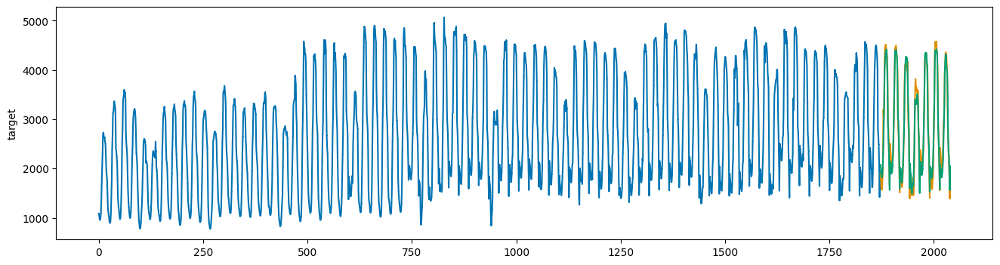

In [ ]:
## 주황색이 실제 전력소비량, 초록색이 예측값입니다.
pred = xgb_reg.predict(x_valid)
pred = pd.Series(pred)
pred.index = np.arange(y_valid.index[0], y_valid.index[-1]+1)
plot_series(y_train, y_valid, pd.Series(pred), markers=[',' , ',', ','])

print('best iterations: {}'.format(xgb_reg.best_iteration))
print('SMAPE : {}'.format(SMAPE(y_valid, pred)))

In [ ]:
xgb_reg = XGBRegressor(n_estimators = 10000, seed=0)

xgb_reg.set_params(**{'objective':weighted_mse(200)})

xgb_reg.fit(x_train, y_train, eval_set=[(x_train, y_train), (x_valid, y_valid)],
        early_stopping_rounds=300,
       verbose=False)

/usr/local/lib/python3.10/dist-packages/xgboost/sklearn.py:835: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=10000, n_jobs=None, num_parallel_tree=None,
             objective=<function weighted_mse.<locals>.weighted_mse_fixed at 0x790fab0d8c10>,
             predictor=None, ...)

best iterations: 55
SMAPE : 14.010058192792412


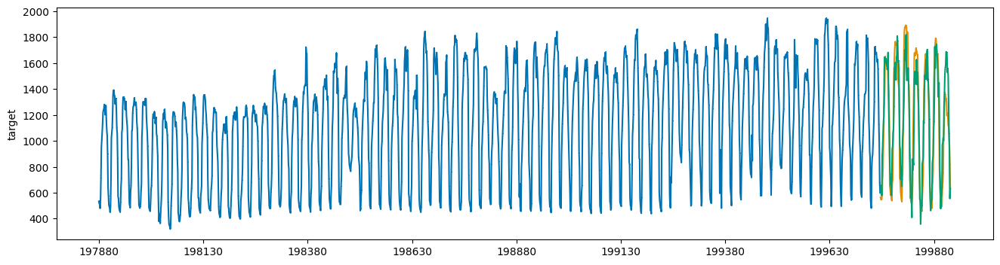

In [ ]:
## 주황색이 실제 전력소비량, 초록색이 예측값입니다.
pred = xgb_reg.predict(x_valid)
pred = pd.Series(pred)
pred.index = np.arange(y_valid.index[0], y_valid.index[-1]+1)
plot_series(y_train, y_valid, pd.Series(pred), markers=[',' , ',', ','])

print('best iterations: {}'.format(xgb_reg.best_iteration))
print('SMAPE : {}'.format(SMAPE(y_valid, pred)))

In [ ]:
!pip install optuna

#전체 xgb param 튜닝 (미완성) weight랑 iter만 수정: 6.8->6.4

In [ ]:
"""
import optuna
from tqdm import tqdm

df = pd.DataFrame(columns = ['n_estimators', 'eta', 'min_child_weight','max_depth', 'colsample_bytree', 'subsample'])
preds = np.array([])

for i in tqdm(range(1,101)):
  def objective(trial):
      # 하이퍼파라미터 범위 설정
      n_estimators = 1000
      eta = trial.suggest_float('eta', 0.001, 0.1)
      min_child_weight = trial.suggest_int('min_child_weight', 3, 9)
      max_depth = trial.suggest_int('max_depth', 3, 9)
      colsample_bytree = trial.suggest_float('colsample_bytree', 0.8, 1.0)
      subsample = trial.suggest_float('subsample', 0.8, 1.0)

      y = train_df.loc[train_df.build_idx == i, 'target']
      x = train_df.loc[train_df.build_idx == i, ].drop(columns='target').iloc[:,1:] #맨 앞의 build_idx 제거

      y_train, y_valid, x_train, x_valid = temporal_train_test_split(y = y, X = x, test_size = 168)
      # XGBoost 모델 생성
      model = XGBRegressor(seed = 0, gpu_id = 0, tree_method = 'gpu_hist', predictor= 'gpu_predictor',
          n_estimators=n_estimators,
          learning_rate=eta,
          min_child_weight=min_child_weight,
          max_depth=max_depth,
          colsample_bytree=colsample_bytree,
          subsample=subsample
      )
      model.fit(x_train,y_train)

      # 교차 검증 수행하여 평균 정확도 계산
      pred = model.predict(x_valid)
      mean_accuracy = SMAPE(y_valid, pred)

      return mean_accuracy

  # Optuna를 사용하여 하이퍼파라미터 최적화 수행
  study = optuna.create_study(direction='minimize')  # maximize는 정확도를 최대화하는 방향으로 탐색합니다.
  study.optimize(objective, n_trials=50)  # n_trials는 시도할 하이퍼파라미터 조합의 수를 의미합니다.

  df = pd.concat([df, pd.DataFrame(study.best_params, index = [0])], axis = 0)
  df.to_csv('/content/drive/MyDrive/hyperparameter_xgb.csv', index = False) # save the tuned parameters
"""


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
  2%|▏         | 2/100 [03:27<2:53:42, 106.35s/it][I 2023-07-29 13:24:03,922] A new study created in memory with name: no-name-8455f918-8628-419a-adb5-a2596b9eb039
[I 2023-07-29 13:24:05,445] Trial 0 finished with value: 15.523243328212047 and parameters: {'eta': 0.05724437457899232, 'min_child_weight': 9, 'max_depth': 4, 'colsample_bytree': 0.8879320040525363, 'subsample': 0.8369222708086933}. Best is trial 0 with value: 15.523243328212047.
[I 2023-07-29 13:24:06,743] Trial 1 finished with value: 17.403230501803595 and parameters: {'eta': 0.07985049021737059, 'min_child_weight': 5, 'max_depth': 3, 'colsample_bytree': 0.8222684052652541, 'subsample': 0.9722224344177567}. Best is trial 0 with value: 15.523243328212047.
[I 2023-07-29 13:24:09,095] Trial 2 finished with value: 15.138136642200239 and parameters: {'eta': 0.017299866670310173, 'min_child_weight': 6, 'max_depth': 8, 'colsample_bytree': 0.9070488226779668, 'subsample': 0.8176768148238478}. B

In [ ]:
xgb_params = pd.read_csv('/content/drive/MyDrive/hyperparameter_xgb.csv')
xgb_params

,n_estimators,eta,min_child_weight,max_depth,colsample_bytree,subsample
0,NaN,0.019599,7,5,0.961437,0.922132
1,NaN,0.088977,3,8,0.857438,0.862142
2,NaN,0.002047,4,9,0.874075,0.806345
3,NaN,0.064222,5,7,0.943305,0.942437
4,NaN,0.008433,7,9,0.999858,0.822410
...,...,...,...,...,...,...
95,NaN,0.003641,7,9,0.900940,0.944759
96,NaN,0.045410,6,4,0.929483,0.848790
97,NaN,0.038241,4,8,0.997768,0.885483
98,NaN,0.015835,7,3,0.961833,0.865603


In [ ]:
import warnings
# 모든 경고 무시
warnings.filterwarnings("ignore")

In [ ]:
scores = [-1]   # smape 값을 저장할 list. index 맞추기위한 -1
best_it = [-1]  # best interation을 저장할 list
for i in tqdm(range(100)):
    y = train_df.loc[train_df.build_idx == i+1 , 'target']
    x = train_df.loc[train_df.build_idx ==i+1, ].drop(columns='target').iloc[:,1:]
    y_train, y_valid, x_train, x_valid = temporal_train_test_split(y = y, X = x, test_size = 168)

    xgb_reg = XGBRegressor(n_estimators = 10000, eta = xgb_params.iloc[i,1],
                           gpu_id = 0, tree_method = 'gpu_hist', predictor= 'gpu_predictor',
                           min_child_weight = xgb_params.iloc[i, 2],
                           max_depth = xgb_params.iloc[i, 3], colsample_bytree = xgb_params.iloc[i, 4],
                           subsample = xgb_params.iloc[i, 5], seed=0)
    xgb_reg.set_params(**{'objective':weighted_mse(100)}) # alpha = 100으로 고정

    xgb_reg.fit(x_train, y_train, eval_set=[(x_train, y_train),
                                            (x_valid, y_valid)], early_stopping_rounds=300, verbose=False)
    y_pred = xgb_reg.predict(x_valid)
    pred = pd.Series(y_pred)

    sm = SMAPE(y_valid, y_pred)
    print(f"build {i+1} score {sm}")
    scores.append(sm)
    best_it.append(xgb_reg.best_iteration) ## 실제 best iteration은 이 값에 +1 해주어야 함.

  1%|          | 1/100 [00:02<03:36,  2.19s/it]

build 1 score 7.216465502291819


  2%|▏         | 2/100 [00:04<03:44,  2.29s/it]

build 2 score 9.839686242157127


  3%|▎         | 3/100 [00:14<09:02,  5.59s/it]

build 3 score 9.534508238054162


  4%|▍         | 4/100 [00:15<06:15,  3.92s/it]

build 4 score 3.7190084925983413


  5%|▌         | 5/100 [00:23<08:50,  5.58s/it]

build 5 score 6.571428682085943


  6%|▌         | 6/100 [00:31<09:37,  6.15s/it]

build 6 score 4.038693278072775


  7%|▋         | 7/100 [00:35<08:38,  5.57s/it]

build 7 score 8.664172921530746


  8%|▊         | 8/100 [00:37<06:46,  4.42s/it]

build 8 score 5.468532880917668


  9%|▉         | 9/100 [00:42<06:45,  4.46s/it]

build 9 score 3.6760669809160325


 10%|█         | 10/100 [00:43<05:23,  3.59s/it]

build 10 score 7.64842971986319


 11%|█         | 11/100 [00:46<05:02,  3.39s/it]

build 11 score 3.472875011196449


 12%|█▏        | 12/100 [00:50<05:12,  3.55s/it]

build 12 score 3.718784723729392


 13%|█▎        | 13/100 [00:53<04:46,  3.30s/it]

build 13 score 4.583325689541877


 14%|█▍        | 14/100 [00:57<05:06,  3.57s/it]

build 14 score 15.705919549623207


 15%|█▌        | 15/100 [00:59<04:23,  3.10s/it]

build 15 score 3.8510429442533334


 16%|█▌        | 16/100 [01:05<05:28,  3.91s/it]

build 16 score 4.399237802660288


 17%|█▋        | 17/100 [01:07<04:38,  3.36s/it]

build 17 score 6.895673979715035


 18%|█▊        | 18/100 [01:12<05:09,  3.77s/it]

build 18 score 7.041401085524665


 19%|█▉        | 19/100 [01:13<04:10,  3.09s/it]

build 19 score 8.270129978178607


 20%|██        | 20/100 [01:16<04:07,  3.09s/it]

build 20 score 9.725497535835657


 21%|██        | 21/100 [01:20<04:13,  3.21s/it]

build 21 score 10.270048137838355


 22%|██▏       | 22/100 [01:22<03:50,  2.95s/it]

build 22 score 4.308667059459959


 23%|██▎       | 23/100 [01:26<03:59,  3.10s/it]

build 23 score 3.38396402919963


 24%|██▍       | 24/100 [01:31<04:40,  3.69s/it]

build 24 score 2.8964520144397077


 25%|██▌       | 25/100 [01:34<04:40,  3.74s/it]

build 25 score 2.329053802543293


 26%|██▌       | 26/100 [01:37<04:02,  3.28s/it]

build 26 score 3.3373708339578547


 27%|██▋       | 27/100 [01:45<06:00,  4.94s/it]

build 27 score 3.0720634404047575


 28%|██▊       | 28/100 [01:49<05:23,  4.50s/it]

build 28 score 4.795449043067368


 29%|██▉       | 29/100 [01:50<04:13,  3.57s/it]

build 29 score 4.525394424477056


 30%|███       | 30/100 [01:54<04:04,  3.49s/it]

build 30 score 7.624389646782349


 31%|███       | 31/100 [01:55<03:14,  2.82s/it]

build 31 score 4.687927850253237


 32%|███▏      | 32/100 [01:57<02:53,  2.55s/it]

build 32 score 0.3967983451501781


 33%|███▎      | 33/100 [01:59<02:46,  2.48s/it]

build 33 score 0.35500780400727733


 34%|███▍      | 34/100 [02:04<03:37,  3.29s/it]

build 34 score 0.6236123291532251


 35%|███▌      | 35/100 [02:11<04:46,  4.41s/it]

build 35 score 0.4933574303933077


 36%|███▌      | 36/100 [02:14<04:05,  3.83s/it]

build 36 score 0.43382516003393834


 37%|███▋      | 37/100 [02:16<03:33,  3.39s/it]

build 37 score 4.588738108146623


 38%|███▊      | 38/100 [02:19<03:19,  3.21s/it]

build 38 score 5.030153160828064


 39%|███▉      | 39/100 [02:27<04:47,  4.71s/it]

build 39 score 5.004331085532229


 40%|████      | 40/100 [02:33<04:57,  4.95s/it]

build 40 score 9.195330839278512


 41%|████      | 41/100 [02:38<04:53,  4.98s/it]

build 41 score 4.411327014485833


 42%|████▏     | 42/100 [02:39<03:49,  3.95s/it]

build 42 score 14.869384310166803


 43%|████▎     | 43/100 [02:42<03:19,  3.51s/it]

build 43 score 5.142835194028763


 44%|████▍     | 44/100 [02:44<02:52,  3.07s/it]

build 44 score 4.2169231009579216


 45%|████▌     | 45/100 [02:50<03:38,  3.98s/it]

build 45 score 2.3832820310946126


 46%|████▌     | 46/100 [02:52<03:04,  3.41s/it]

build 46 score 5.8146210412662995


 47%|████▋     | 47/100 [02:56<03:07,  3.54s/it]

build 47 score 4.318253144964249


 48%|████▊     | 48/100 [03:00<03:08,  3.63s/it]

build 48 score 2.0047444367294314


 49%|████▉     | 49/100 [03:03<02:53,  3.40s/it]

build 49 score 1.9790908662291182


 50%|█████     | 50/100 [03:06<02:53,  3.47s/it]

build 50 score 1.9056081761333516


 51%|█████     | 51/100 [03:08<02:24,  2.94s/it]

build 51 score 3.4397239480305215


 52%|█████▏    | 52/100 [03:10<02:08,  2.67s/it]

build 52 score 4.888589043624409


 53%|█████▎    | 53/100 [03:12<02:01,  2.59s/it]

build 53 score 14.879768754518462


 54%|█████▍    | 54/100 [03:20<03:08,  4.09s/it]

build 54 score 30.87282149892605


 55%|█████▌    | 55/100 [03:22<02:36,  3.47s/it]

build 55 score 1.9020015001416097


 56%|█████▌    | 56/100 [03:26<02:44,  3.75s/it]

build 56 score 0.8300266045222873


 57%|█████▋    | 57/100 [03:32<03:06,  4.35s/it]

build 57 score 5.309303083175113


 58%|█████▊    | 58/100 [03:35<02:46,  3.95s/it]

build 58 score 0.3842980556317706


 59%|█████▉    | 59/100 [03:39<02:39,  3.88s/it]

build 59 score 5.695447570759222


 60%|██████    | 60/100 [03:43<02:37,  3.93s/it]

build 60 score 5.4643373011381735


 61%|██████    | 61/100 [03:45<02:09,  3.31s/it]

build 61 score 4.9028070853508465


 62%|██████▏   | 62/100 [03:46<01:44,  2.74s/it]

build 62 score 5.410639672444819


 63%|██████▎   | 63/100 [03:52<02:13,  3.60s/it]

build 63 score 4.954989294994532


 64%|██████▍   | 64/100 [04:09<04:34,  7.63s/it]

build 64 score 3.6496160566802507


 65%|██████▌   | 65/100 [04:13<03:46,  6.48s/it]

build 65 score 8.245189770842945


 66%|██████▌   | 66/100 [04:16<03:11,  5.64s/it]

build 66 score 3.715226375337383


 67%|██████▋   | 67/100 [04:22<03:04,  5.58s/it]

build 67 score 4.451416564331921


 68%|██████▊   | 68/100 [04:23<02:18,  4.33s/it]

build 68 score 5.163903522501362


 69%|██████▉   | 69/100 [04:26<01:56,  3.75s/it]

build 69 score 2.7699367996163033


 70%|███████   | 70/100 [04:28<01:44,  3.48s/it]

build 70 score 5.172079943931011


 71%|███████   | 71/100 [04:31<01:30,  3.12s/it]

build 71 score 5.875377482664753


 72%|███████▏  | 72/100 [04:33<01:23,  2.97s/it]

build 72 score 6.0048229133952615


 73%|███████▎  | 73/100 [04:35<01:06,  2.45s/it]

build 73 score 3.8456442955479555


 74%|███████▍  | 74/100 [04:37<01:01,  2.36s/it]

build 74 score 6.517674785606278


 75%|███████▌  | 75/100 [04:42<01:24,  3.38s/it]

build 75 score 3.7606501263659795


 76%|███████▌  | 76/100 [04:43<01:04,  2.69s/it]

build 76 score 4.420969069275682


 77%|███████▋  | 77/100 [04:45<00:54,  2.37s/it]

build 77 score 2.6157755897831527


 78%|███████▊  | 78/100 [04:47<00:51,  2.36s/it]

build 78 score 3.725897831296835


 79%|███████▉  | 79/100 [04:49<00:43,  2.07s/it]

build 79 score 2.9972169343003974


 80%|████████  | 80/100 [04:51<00:42,  2.13s/it]

build 80 score 4.30252973600599


 81%|████████  | 81/100 [04:53<00:39,  2.06s/it]

build 81 score 4.250682738506927


 82%|████████▏ | 82/100 [04:56<00:42,  2.35s/it]

build 82 score 7.08585001009165


 83%|████████▎ | 83/100 [05:26<02:59, 10.55s/it]

build 83 score 3.148352708319388


 84%|████████▍ | 84/100 [05:32<02:27,  9.22s/it]

build 84 score 2.730325903814594


 85%|████████▌ | 85/100 [05:36<01:53,  7.58s/it]

build 85 score 3.424688152531767


 86%|████████▌ | 86/100 [05:37<01:21,  5.82s/it]

build 86 score 5.720430277921987


 87%|████████▋ | 87/100 [05:43<01:13,  5.64s/it]

build 87 score 8.936057156025731


 88%|████████▊ | 88/100 [05:49<01:11,  5.93s/it]

build 88 score 9.163672859172227


 89%|████████▉ | 89/100 [05:56<01:09,  6.30s/it]

build 89 score 9.996922871319363


 90%|█████████ | 90/100 [05:58<00:48,  4.88s/it]

build 90 score 7.611788318620231


 91%|█████████ | 91/100 [06:00<00:36,  4.03s/it]

build 91 score 13.705714813667552


 92%|█████████▏| 92/100 [06:03<00:28,  3.60s/it]

build 92 score 7.265591567016676


 93%|█████████▎| 93/100 [06:06<00:24,  3.55s/it]

build 93 score 6.86191995872741


 94%|█████████▍| 94/100 [06:09<00:20,  3.40s/it]

build 94 score 6.9693993702424075


 95%|█████████▌| 95/100 [06:15<00:21,  4.26s/it]

build 95 score 14.126577827551351


 96%|█████████▌| 96/100 [06:26<00:24,  6.14s/it]

build 96 score 3.3227383256955996


 97%|█████████▋| 97/100 [06:28<00:14,  4.93s/it]

build 97 score 5.525303355441981


 98%|█████████▊| 98/100 [06:32<00:09,  4.69s/it]

build 98 score 12.603860671325867


 99%|█████████▉| 99/100 [06:40<00:05,  5.76s/it]

build 99 score 4.83662941368535


100%|██████████| 100/100 [06:45<00:00,  4.06s/it]

build 100 score 5.521365077005081


In [ ]:
np.mean(sm)

5.521365077005081

In [ ]:
alpha_list = [-1] #index 맞추기위한 -1
smape_list = [-1]
for i in tqdm(range(100)):
    y = train_df.loc[train_df.build_idx == i+1 , 'target']
    x = train_df.loc[train_df.build_idx ==i+1 , ].drop(columns='target').iloc[:,1:]
    y_train, y_test, x_train, x_test = temporal_train_test_split(y = y, X = x, test_size = 168)
    xgb = XGBRegressor(seed = 0, gpu_id = 0, tree_method = 'gpu_hist', predictor= 'gpu_predictor',
                      n_estimators = best_it[i+1], eta = xgb_params.iloc[i,1], min_child_weight = xgb_params.iloc[i, 2],
                      max_depth = xgb_params.iloc[i, 3], colsample_bytree = xgb_params.iloc[i, 4], subsample = xgb_params.iloc[i, 5])

    xgb.fit(x_train, y_train)
    pred0 = xgb.predict(x_test)
    best_alpha = 0
    score0 = SMAPE(y_test,pred0)

    for j in [1, 3, 5, 7, 10, 25, 50, 75, 100]:
        xgb = XGBRegressor(seed = 0, gpu_id = 0, tree_method = 'gpu_hist', predictor= 'gpu_predictor',
                      n_estimators = best_it[i+1], eta = xgb_params.iloc[i,1], min_child_weight = xgb_params.iloc[i, 2],
                      max_depth = xgb_params.iloc[i, 3], colsample_bytree = xgb_params.iloc[i, 4], subsample = xgb_params.iloc[i, 5])
        xgb.set_params(**{'objective' : weighted_mse(j)})

        xgb.fit(x_train, y_train)
        pred1 = xgb.predict(x_test)
        score1 = SMAPE(y_test, pred1)
        if score1 < score0:
            best_alpha = j
            score0 = score1

    alpha_list.append(best_alpha)
    smape_list.append(score0)
    print("building {} || best score : {} || alpha : {}".format(i+1, score0, best_alpha))

  1%|          | 1/100 [00:05<09:04,  5.50s/it]

building 1 || best score : 6.603459702285217 || alpha : 0


  2%|▏         | 2/100 [00:07<05:19,  3.26s/it]

building 2 || best score : 8.567920616952346 || alpha : 3


  3%|▎         | 3/100 [01:07<47:41, 29.50s/it]

building 3 || best score : 8.801096874634082 || alpha : 0


  4%|▍         | 4/100 [01:09<29:34, 18.48s/it]

building 4 || best score : 3.731748398839048 || alpha : 100


  5%|▌         | 5/100 [01:59<47:09, 29.78s/it]

building 5 || best score : 6.561262548569406 || alpha : 75


  6%|▌         | 6/100 [02:50<57:47, 36.88s/it]

building 6 || best score : 4.015335963820048 || alpha : 75


  7%|▋         | 7/100 [03:04<45:36, 29.43s/it]

building 7 || best score : 8.458674477658535 || alpha : 0


  8%|▊         | 8/100 [03:07<32:39, 21.30s/it]

building 8 || best score : 4.983346979222744 || alpha : 1


  9%|▉         | 9/100 [03:41<38:06, 25.13s/it]

building 9 || best score : 2.7783142745657714 || alpha : 0


 10%|█         | 10/100 [03:43<26:44, 17.83s/it]

building 10 || best score : 7.027057990673032 || alpha : 0


 11%|█         | 11/100 [03:57<24:55, 16.80s/it]

building 11 || best score : 3.460268277704649 || alpha : 50


 12%|█▏        | 12/100 [04:13<24:13, 16.52s/it]

building 12 || best score : 3.4873083881788163 || alpha : 10


 13%|█▎        | 13/100 [04:27<23:03, 15.90s/it]

building 13 || best score : 4.538670708263337 || alpha : 10


 14%|█▍        | 14/100 [04:54<27:22, 19.10s/it]

building 14 || best score : 15.707964912104073 || alpha : 100


 15%|█▌        | 15/100 [04:59<20:55, 14.78s/it]

building 15 || best score : 3.6471469240207126 || alpha : 3


 16%|█▌        | 16/100 [05:30<27:38, 19.74s/it]

building 16 || best score : 4.309016966553831 || alpha : 1


 17%|█▋        | 17/100 [05:34<20:50, 15.06s/it]

building 17 || best score : 6.57654021921957 || alpha : 7


 18%|█▊        | 18/100 [06:04<26:49, 19.63s/it]

building 18 || best score : 6.593902359675699 || alpha : 0


 19%|█▉        | 19/100 [06:08<19:54, 14.74s/it]

building 19 || best score : 8.108209927713556 || alpha : 75


 20%|██        | 20/100 [06:19<18:10, 13.63s/it]

building 20 || best score : 8.566577136163406 || alpha : 0


 21%|██        | 21/100 [06:24<14:45, 11.21s/it]

building 21 || best score : 8.783982169395333 || alpha : 0


 22%|██▏       | 22/100 [06:38<15:27, 11.89s/it]

building 22 || best score : 3.9239867227836935 || alpha : 1


 23%|██▎       | 23/100 [06:41<12:04,  9.41s/it]

building 23 || best score : 3.3851128383383657 || alpha : 100


 24%|██▍       | 24/100 [06:52<12:21,  9.76s/it]

building 24 || best score : 2.3203869259995784 || alpha : 0


 25%|██▌       | 25/100 [06:56<10:04,  8.06s/it]

building 25 || best score : 2.1141873194828538 || alpha : 3


 26%|██▌       | 26/100 [07:02<09:09,  7.43s/it]

building 26 || best score : 3.180381014383714 || alpha : 0


 27%|██▋       | 27/100 [07:58<26:38, 21.90s/it]

building 27 || best score : 2.514030128611897 || alpha : 0


 28%|██▊       | 28/100 [08:13<24:02, 20.03s/it]

building 28 || best score : 4.795966978845513 || alpha : 7


 29%|██▉       | 29/100 [08:15<17:14, 14.57s/it]

building 29 || best score : 4.459739913547095 || alpha : 50


 30%|███       | 30/100 [08:32<17:42, 15.18s/it]

building 30 || best score : 7.63588061060376 || alpha : 100


 31%|███       | 31/100 [08:34<12:58, 11.28s/it]

building 31 || best score : 4.699092853760565 || alpha : 25


 32%|███▏      | 32/100 [08:43<12:05, 10.67s/it]

building 32 || best score : 0.39621708719423543 || alpha : 5


 33%|███▎      | 33/100 [08:49<10:17,  9.21s/it]

building 33 || best score : 0.33470634123115267 || alpha : 0


 34%|███▍      | 34/100 [09:07<12:54, 11.73s/it]

building 34 || best score : 0.6239434561674263 || alpha : 100


 35%|███▌      | 35/100 [09:46<21:51, 20.18s/it]

building 35 || best score : 0.48712970885508255 || alpha : 75


 36%|███▌      | 36/100 [10:03<20:15, 19.00s/it]

building 36 || best score : 0.39513121348816055 || alpha : 0


 37%|███▋      | 37/100 [10:11<16:31, 15.73s/it]

building 37 || best score : 4.070497098615646 || alpha : 5


 38%|███▊      | 38/100 [10:14<12:13, 11.83s/it]

building 38 || best score : 4.212029684761937 || alpha : 0


 39%|███▉      | 39/100 [11:06<24:32, 24.14s/it]

building 39 || best score : 4.981663906096862 || alpha : 5


 40%|████      | 40/100 [11:26<22:46, 22.77s/it]

building 40 || best score : 8.691709917071588 || alpha : 0


 41%|████      | 41/100 [11:36<18:42, 19.03s/it]

building 41 || best score : 4.157420134545661 || alpha : 1


 42%|████▏     | 42/100 [11:37<13:11, 13.64s/it]

building 42 || best score : 14.482424532612182 || alpha : 7


 43%|████▎     | 43/100 [11:44<10:51, 11.43s/it]

building 43 || best score : 4.810083646637112 || alpha : 1


 44%|████▍     | 44/100 [11:47<08:30,  9.11s/it]

building 44 || best score : 3.8536727023709116 || alpha : 5


 45%|████▌     | 45/100 [12:18<14:21, 15.67s/it]

building 45 || best score : 1.9752631624312296 || alpha : 0


 46%|████▌     | 46/100 [12:30<13:00, 14.45s/it]

building 46 || best score : 5.64478898112594 || alpha : 3


 47%|████▋     | 47/100 [12:52<14:44, 16.69s/it]

building 47 || best score : 4.050677518942257 || alpha : 0


 48%|████▊     | 48/100 [13:10<14:47, 17.07s/it]

building 48 || best score : 2.0065464899477305 || alpha : 100


 49%|████▉     | 49/100 [13:20<12:45, 15.01s/it]

building 49 || best score : 1.9615570669476026 || alpha : 75


 50%|█████     | 50/100 [13:40<13:50, 16.62s/it]

building 50 || best score : 1.9031965105200639 || alpha : 50


 51%|█████     | 51/100 [13:46<10:51, 13.29s/it]

building 51 || best score : 3.4409598241037678 || alpha : 100


 52%|█████▏    | 52/100 [13:51<08:33, 10.70s/it]

building 52 || best score : 4.528931164630878 || alpha : 0


 53%|█████▎    | 53/100 [14:00<08:06, 10.36s/it]

building 53 || best score : 13.92678573865192 || alpha : 5


 54%|█████▍    | 54/100 [14:44<15:45, 20.56s/it]

building 54 || best score : 30.29565971243994 || alpha : 0


 55%|█████▌    | 55/100 [14:50<12:06, 16.15s/it]

building 55 || best score : 1.8045640556972438 || alpha : 7


 56%|█████▌    | 56/100 [15:21<14:57, 20.39s/it]

building 56 || best score : 0.829930224317307 || alpha : 100


 57%|█████▋    | 57/100 [15:45<15:32, 21.68s/it]

building 57 || best score : 4.965211765608525 || alpha : 3


 58%|█████▊    | 58/100 [16:00<13:42, 19.57s/it]

building 58 || best score : 0.3695500260740885 || alpha : 3


 59%|█████▉    | 59/100 [16:12<11:49, 17.31s/it]

building 59 || best score : 5.499696975967679 || alpha : 50


 60%|██████    | 60/100 [16:33<12:14, 18.37s/it]

building 60 || best score : 5.065553797439187 || alpha : 0


 61%|██████    | 61/100 [16:35<08:48, 13.56s/it]

building 61 || best score : 4.539504013647301 || alpha : 3


 62%|██████▏   | 62/100 [16:37<06:20, 10.01s/it]

building 62 || best score : 5.314597195461416 || alpha : 3


 63%|██████▎   | 63/100 [17:13<10:57, 17.76s/it]

building 63 || best score : 4.718712186040892 || alpha : 0


 64%|██████▍   | 64/100 [19:18<30:04, 50.12s/it]

building 64 || best score : 3.41881602210845 || alpha : 0


 65%|██████▌   | 65/100 [19:25<21:36, 37.04s/it]

building 65 || best score : 7.708061244542385 || alpha : 0


 66%|██████▌   | 66/100 [19:39<17:09, 30.28s/it]

building 66 || best score : 3.2238218291839758 || alpha : 0


 67%|██████▋   | 67/100 [20:05<15:48, 28.75s/it]

building 67 || best score : 4.406509289897308 || alpha : 7


 68%|██████▊   | 68/100 [20:06<10:56, 20.50s/it]

building 68 || best score : 4.94281355752867 || alpha : 0


 69%|██████▉   | 69/100 [20:08<07:45, 15.03s/it]

building 69 || best score : 2.557267087549863 || alpha : 0


 70%|███████   | 70/100 [20:15<06:13, 12.45s/it]

building 70 || best score : 4.865477718039485 || alpha : 3


 71%|███████   | 71/100 [20:20<05:00, 10.35s/it]

building 71 || best score : 5.520578548627969 || alpha : 0


 72%|███████▏  | 72/100 [20:30<04:46, 10.23s/it]

building 72 || best score : 5.9950871901854255 || alpha : 75


 73%|███████▎  | 73/100 [20:32<03:28,  7.72s/it]

building 73 || best score : 3.253140353027083 || alpha : 0


 74%|███████▍  | 74/100 [20:37<02:57,  6.81s/it]

building 74 || best score : 5.477021490940454 || alpha : 0


 75%|███████▌  | 75/100 [21:04<05:22, 12.88s/it]

building 75 || best score : 3.759976738085893 || alpha : 100


 76%|███████▌  | 76/100 [21:05<03:46,  9.43s/it]

building 76 || best score : 4.417167303605813 || alpha : 25


 77%|███████▋  | 77/100 [21:10<03:07,  8.13s/it]

building 77 || best score : 2.391823366289996 || alpha : 0


 78%|███████▊  | 78/100 [21:16<02:44,  7.48s/it]

building 78 || best score : 3.2949178951384273 || alpha : 0


 79%|███████▉  | 79/100 [21:18<02:04,  5.92s/it]

building 79 || best score : 3.00283762702912 || alpha : 100


 80%|████████  | 80/100 [21:26<02:08,  6.41s/it]

building 80 || best score : 4.08977456566393 || alpha : 3


 81%|████████  | 81/100 [21:29<01:42,  5.38s/it]

building 81 || best score : 3.602587292999656 || alpha : 1


 82%|████████▏ | 82/100 [21:37<01:50,  6.15s/it]

building 82 || best score : 5.167089281999993 || alpha : 0


 83%|████████▎ | 83/100 [25:22<20:23, 71.97s/it]

building 83 || best score : 3.0411026874694014 || alpha : 10


 84%|████████▍ | 84/100 [26:05<16:52, 63.25s/it]

building 84 || best score : 2.633386776684571 || alpha : 5


 85%|████████▌ | 85/100 [26:25<12:32, 50.16s/it]

building 85 || best score : 3.2086611692587046 || alpha : 0


 86%|████████▌ | 86/100 [26:26<08:16, 35.49s/it]

building 86 || best score : 5.658280601477431 || alpha : 100


 87%|████████▋ | 87/100 [26:56<07:17, 33.69s/it]

building 87 || best score : 8.913879148885986 || alpha : 75


 88%|████████▊ | 88/100 [27:41<07:24, 37.08s/it]

building 88 || best score : 9.16341357984345 || alpha : 100


 89%|████████▉ | 89/100 [28:21<06:59, 38.11s/it]

building 89 || best score : 9.62667730383562 || alpha : 7


 90%|█████████ | 90/100 [28:26<04:40, 28.08s/it]

building 90 || best score : 6.8505379220081695 || alpha : 25


 91%|█████████ | 91/100 [28:38<03:28, 23.19s/it]

building 91 || best score : 12.832902618264082 || alpha : 7


 92%|█████████▏| 92/100 [28:49<02:38, 19.76s/it]

building 92 || best score : 7.216998545395982 || alpha : 75


 93%|█████████▎| 93/100 [29:00<01:58, 17.00s/it]

building 93 || best score : 6.175162937058137 || alpha : 0


 94%|█████████▍| 94/100 [29:14<01:37, 16.27s/it]

building 94 || best score : 6.466644066614504 || alpha : 3


 95%|█████████▌| 95/100 [29:57<02:01, 24.26s/it]

building 95 || best score : 13.769210776485993 || alpha : 1


 96%|█████████▌| 96/100 [30:50<02:11, 32.77s/it]

building 96 || best score : 2.7376291216378834 || alpha : 1


 97%|█████████▋| 97/100 [30:55<01:13, 24.46s/it]

building 97 || best score : 5.10563814611544 || alpha : 0


 98%|█████████▊| 98/100 [31:17<00:47, 23.86s/it]

building 98 || best score : 12.308221240532466 || alpha : 0


 99%|█████████▉| 99/100 [31:25<00:18, 18.91s/it]

building 99 || best score : 4.17625506368065 || alpha : 1


100%|██████████| 100/100 [31:42<00:00, 19.03s/it]

building 100 || best score : 5.056093204392902 || alpha : 3


In [ ]:
np.mean(smape_list)

5.2842608938049365

In [ ]:
np.mean(smape_list)

5.381277148731877

In [ ]:
check = np.array(smape_list) #이상치 큰 인덱스들 탐색

indices_greater_than_10 = np.where(check > 10)

print(indices_greater_than_10)

(array([14, 42, 53, 54, 87, 91, 95, 98]),)


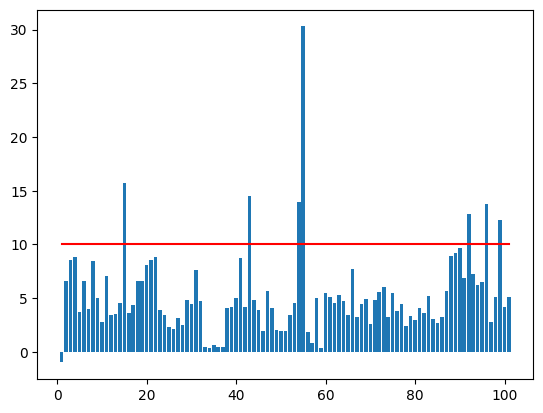

In [ ]:
no_df = pd.DataFrame({'score':smape_list})
plt.bar(np.arange(len(no_df))+1, no_df['score'])
plt.plot([1,101], [10, 10], color = 'red')

#predict

In [ ]:
preds = np.array([])
for i in tqdm(range(100)):

    pred_df = pd.DataFrame()   # 시드별 예측값을 담을 data frame

    for seed in [0]: # 각 시드별 예측, 지금은 하나만
        y_train = train_df.loc[train_df.build_idx == i+1, 'target']
        x_train, x_test = train_df.loc[train_df.build_idx == i+1, ].drop(columns='target').iloc[:,1:] , test_df.loc[test_df.build_idx == i+1, ].iloc[:,1:]
        x_test = x_test[x_train.columns]

        xgb = XGBRegressor(seed = seed, n_estimators = best_it[i+1]+1, eta = xgb_params.iloc[i,1],
                           min_child_weight = xgb_params.iloc[i, 2], max_depth = xgb_params.iloc[i, 3],
                           colsample_bytree=xgb_params.iloc[i, 4], subsample=xgb_params.iloc[i, 5],
                           gpu_id = 0, tree_method = 'gpu_hist', predictor= 'gpu_predictor')

        if(alpha_list[i]!=0):
          xgb.set_params(**{'objective':weighted_mse( alpha_list[i+1]) })

        xgb.fit(x_train, y_train)
        y_pred = xgb.predict(x_test)
        pred_df.loc[:,seed] = y_pred   # 각 시드별 예측 담기

    pred = pred_df.mean(axis=1)        # (i+1)번째 건물의 예측 =  (i+1)번째 건물의 각 시드별 예측 평균값
    preds = np.append(preds, pred)

100%|██████████| 100/100 [02:27<00:00,  1.47s/it]


In [ ]:
preds = pd.Series(preds)

fig, ax = plt.subplots(100, 1, figsize=(100,200), sharex = True)
ax = ax.flatten()
for i in range(100):
    train_y = train_df.loc[train_df.build_idx == i+1 , 'target'].reset_index(drop = True)
    test_y = preds[i*168:(i+1)*168]
    ax[i].scatter(np.arange(2040) , train_df.loc[train_df.build_idx == i+1, 'target'])
    ax[i].scatter(np.arange(2040, 2040+168 ) , test_y)
    ax[i].tick_params(axis='both', which='major', labelsize=6)
    ax[i].tick_params(axis='both', which='minor', labelsize=4)
#plt.savefig('./predict_xgb.png')
plt.show()

In [ ]:
submission = pd.read_csv('sample_submission.csv')
submission['answer'] = preds
submission.to_csv('submit.csv', index = False)

#후처리 (오히려 성능 떨어짐)

In [ ]:
train_to_post = pd.read_csv('train.csv')
cols = ['num_date','build_idx','yyyymmdd hh','temp','rain_amount','wind','humid','일조','일사','target']
train_to_post.columns = cols
date = pd.to_datetime(train_to_post['yyyymmdd hh'], format='%Y%m%d %H')
train_to_post['hour'] = date.dt.hour
train_to_post['day'] = date.dt.weekday
train_to_post['month'] = date.dt.month
train_to_post['week'] = date.dt.weekofyear
train_to_post = train_to_post.reset_index(drop = True)

pred_clip = []
test_to_post = pd.read_csv('test.csv')
cols = ['num_date','build_idx','yyyymmdd hh','temp','rain_amount','wind','humid']
test_to_post.columns = cols
date = pd.to_datetime(test_to_post['yyyymmdd hh'], format='%Y%m%d %H')
test_to_post['hour'] = date.dt.hour
test_to_post['day'] = date.dt.weekday
test_to_post['month'] = date.dt.month
test_to_post['week'] = date.dt.weekofyear

## submission 불러오기
df = pd.read_csv('submit.csv')
for i in range(100):
    min_data = train_to_post.loc[train_to_post.build_idx == i+1, ].iloc[-28*24:, :] ## 건물별로 직전 28일의 데이터 불러오기
    ## 요일별, 시간대별 최솟값 계산
    min_data = pd.pivot_table(min_data, values = 'target', index = ['day', 'hour'], aggfunc = min).reset_index()
    pred = df.answer[168*i:168*(i+1)].reset_index(drop=True) ## 168개 데이터, 즉 건물별 예측값 불러오기
    day =  test_to_post.day[168*i:168*(i+1)].reset_index(drop=True) ## 예측값 요일 불러오기
    hour = test_to_post.hour[168*i:168*(i+1)].reset_index(drop=True) ## 예측값 시간 불러오기
    df_pred = pd.concat([pred, day, hour], axis = 1)
    df_pred.columns = ['pred', 'day', 'hour']
    for j in range(len(df_pred)):
        min_power = min_data.loc[(min_data.day == df_pred.day[j])&(min_data.hour == df_pred.hour[j]), 'target'].values[0]
        if df_pred.pred[j] < min_power:
            pred_clip.append(min_power)
        else:
            pred_clip.append(df_pred.pred[j])

<ipython-input-109-0fc8117614f4>:8: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  train_to_post['week'] = date.dt.weekofyear
<ipython-input-109-0fc8117614f4>:19: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  test_to_post['week'] = date.dt.weekofyear


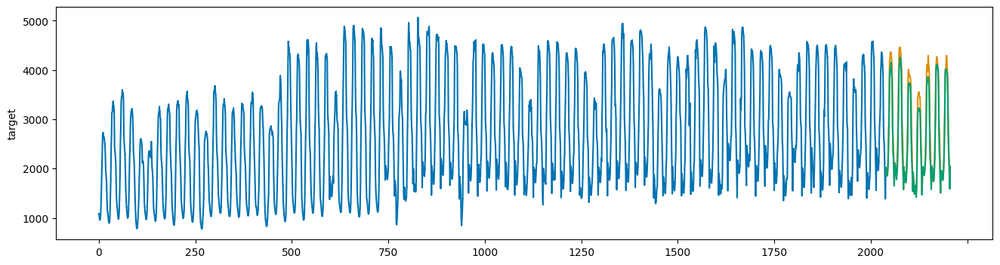

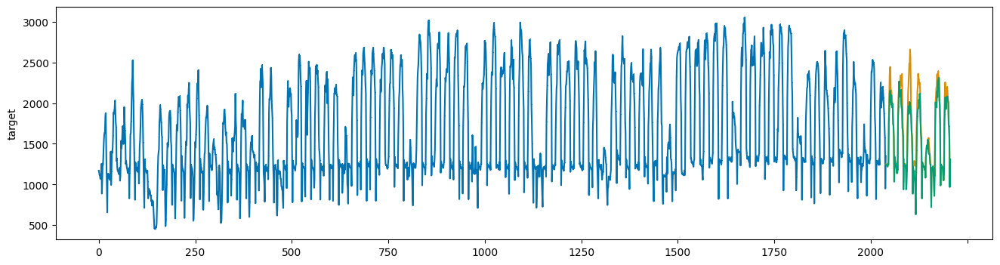

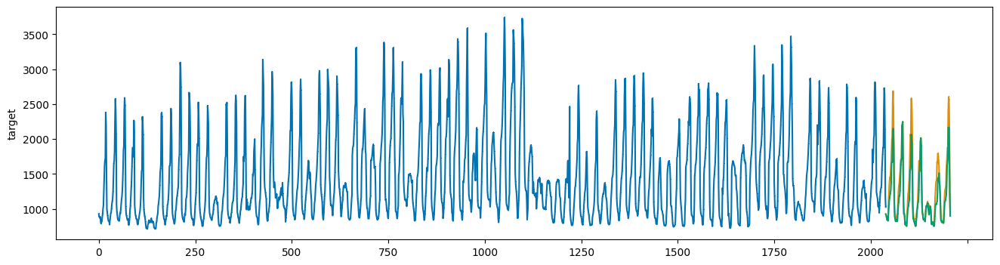

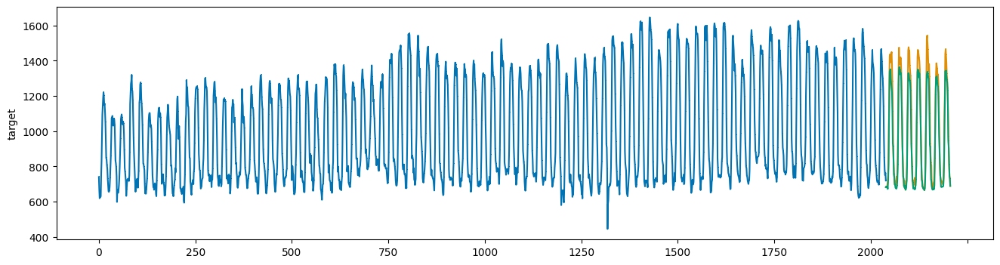

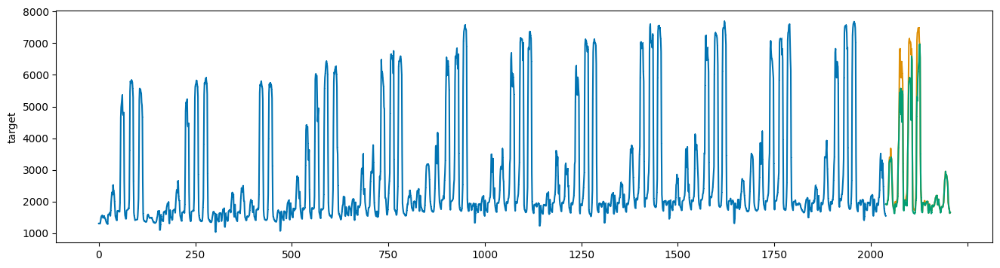

...

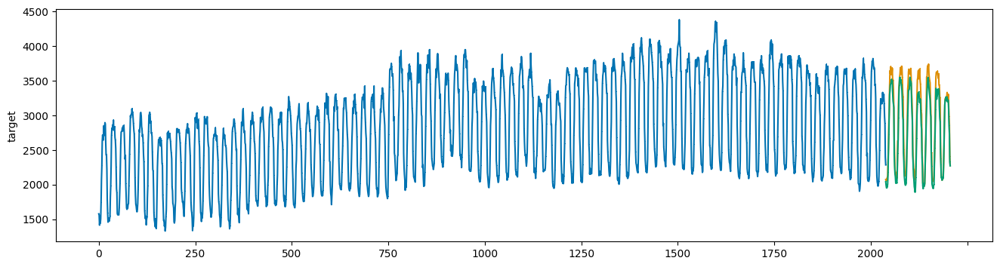

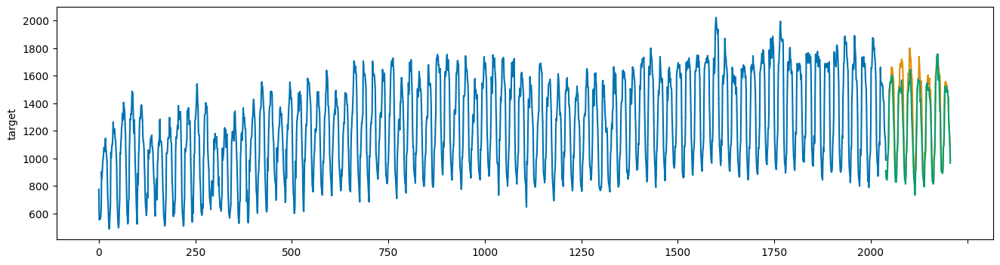

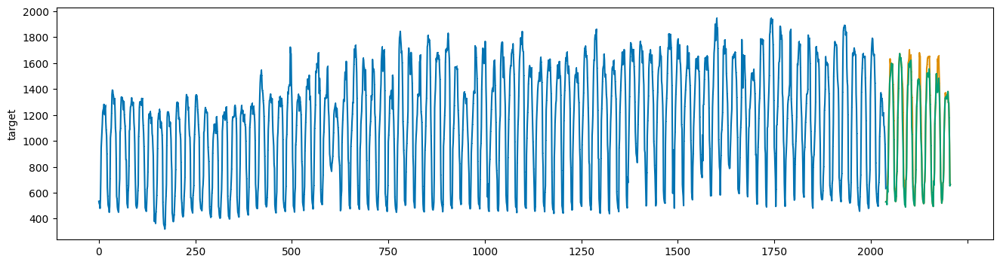

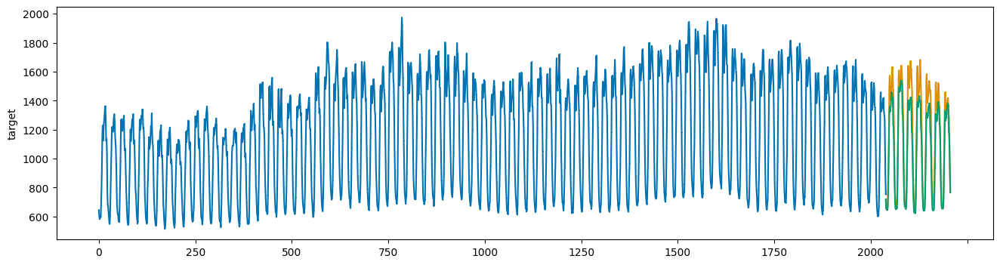

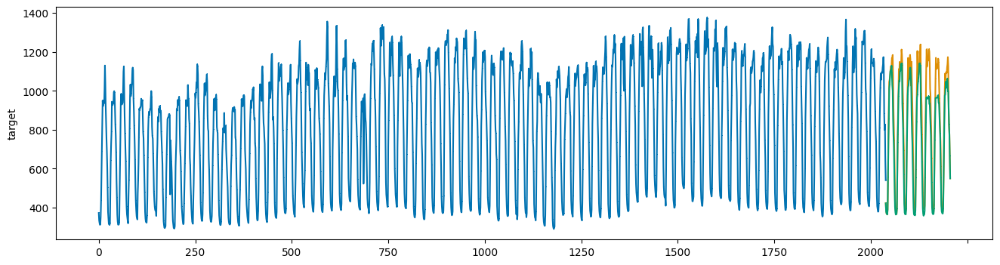

In [ ]:
pred_origin = df.answer #초록 원래 주황 후처리
pred_clip = pd.Series(pred_clip)

for i in range(100):
    power = train_to_post.loc[train_to_post.build_idx == i+1, 'target'].reset_index(drop=True)
    preds = pred_clip[i*168:(i+1)*168]
    preds_origin = pred_origin[i*168:(i+1)*168]
    preds.index = range(power.index[-1], power.index[-1]+168)
    preds_origin.index = range(power.index[-1], power.index[-1]+168)

    plot_series(power, preds,  preds_origin, markers = [',', ',', ','])

#제출

In [ ]:
submission = pd.read_csv('sample_submission.csv')
submission['answer'] = pred_clip
submission.to_csv('submit_clip.csv', index = False)